In [ ]:
import pandas as pd
import seaborn as sns
import matplotlib as plt
from pandas_profiling import ProfileReport 
#Please note you need to import from ydata_profiling import ProfileReport to run docker image.
import calendar
import os

%pylab inline

In [2]:
#Read in data: Please note you need to set up the dir according to your docker container.
file ='/data/leuven/351/vsc35102/scratch/Full_Data_Set/Project_dataframe.csv'
dataframe = pd.read_csv(file, sep = ';')

In [3]:
dataframe

,object_id,result_timestamp,laeq,hour,day_of_week,month,weekend,holiday,exam_period,key,...,LC_RAD,LC_RAININ,LC_DAILYRAIN,LC_WINDDIR,LC_WINDSPEED,LC_RAD60,LC_TEMP_QCL0,LC_TEMP_QCL1,LC_TEMP_QCL2,LC_TEMP_QCL3
0,255441,2022-01-01 00:00:00+01:00,63.267554,0,5,1,True,True,False,2554412022-01-01 00:00:00+01:00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,255442,2022-01-01 00:00:00+01:00,54.756500,0,5,1,True,True,False,2554422022-01-01 00:00:00+01:00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,255443,2022-01-01 00:00:00+01:00,54.790667,0,5,1,True,True,False,2554432022-01-01 00:00:00+01:00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,255444,2022-01-01 00:00:00+01:00,51.906667,0,5,1,True,True,False,2554442022-01-01 00:00:00+01:00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,255441,2022-01-01 00:10:00+01:00,60.254000,0,5,1,True,True,False,2554412022-01-01 00:10:00+01:00,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
332414,255442,2022-12-31 23:50:00+01:00,57.261436,23,5,12,True,True,False,2554422022-12-31 23:50:00+01:00,...,0.0,0.0,0.001,-45.0,0.3,0.0,16.48,16.48,16.423,16.43343
332415,255443,2022-12-31 23:50:00+01:00,57.698331,23,5,12,True,True,False,2554432022-12-31 23:50:00+01:00,...,0.0,0.0,0.001,-45.0,0.3,0.0,16.48,16.48,16.423,16.43343
332416,255444,2022-12-31 23:50:00+01:00,52.716361,23,5,12,True,True,False,2554442022-12-31 23:50:00+01:00,...,0.0,0.0,0.001,-45.0,0.3,0.0,16.48,16.48,16.423,16.43343
332417,280324,2022-12-31 23:50:00+01:00,59.575793,23,5,12,True,True,False,2803242022-12-31 23:50:00+01:00,...,0.0,0.0,0.001,-45.0,0.3,0.0,16.48,16.48,16.423,16.43343


In [4]:
# Overview of missing data.
print("missing_data:", dataframe.isna().sum())

missing_data: object_id             0
result_timestamp      0
laeq                  0
hour                  0
day_of_week           0
month                 0
weekend               0
holiday               0
exam_period           0
key                   0
255439                0
255440                0
255441                0
255442                0
255443                0
255444                0
255445                0
280324                0
303910                0
ID                   28
LC_HUMIDITY          67
LC_DWPTEMP           67
LC_n                 67
LC_RAD               67
LC_RAININ            67
LC_DAILYRAIN         67
LC_WINDDIR           67
LC_WINDSPEED         67
LC_RAD60             28
LC_TEMP_QCL0         67
LC_TEMP_QCL1        411
LC_TEMP_QCL2        411
LC_TEMP_QCL3        411
dtype: int64


In [5]:
# Set up datatime and string types.
dataframe['result_timestamp'] = pd.to_datetime(dataframe['result_timestamp'],utc = True)
#dataframe['#object_id'] = dataframe['#object_id'].astype(str)


In [7]:
# Build a profile for a quick EDA look.
profile = ProfileReport(dataframe, title="Noise dataset", html={'style': {'full_width': True}}, sort= None)
profile


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
# Display the average laeq value per weekday for each month for each object id 
sampled_df = dataframe.groupby(['day_of_week','object_id', 'month', 'hour'])['laeq'].mean().reset_index()

# Add the location variable 
sampled_df['object_id'] = sampled_df['object_id'].astype(int)


# Define a dictionary mapping object_id to location information
location_dict = {
    255439: "Naamsestraat 35, Maxim",
    255440: "Naamsestraat 57, Xior",
    255441: "Naamsestraat 62, Taste",
    255442: "Calvariekapel, KU Leuven",
    255443: "Parkstraat 2, La Filosovia",
    255444: "Naamsestraat 81",
    255445: "Kiosk, Stadspark",
    280324: "Vrijthof",
    303910: "His Hears"
}

# Add the 'Location' column to the sampled_df DataFrame
sampled_df['Location'] = sampled_df['object_id'].map(location_dict)

In [7]:
# Display yearly average hour in a weekday each location
yearly_sampled_df = dataframe.groupby(['object_id', 'hour', 'day_of_week'])['laeq'].mean().reset_index()

yearly_sampled_df['object_id'] = yearly_sampled_df['object_id'].astype(int)

# Define a dictionary mapping object_id to location information
location_dict = {
    255439: "Naamsestraat 35, Maxim",
    255440: "Naamsestraat 57, Xior",
    255441: "Naamsestraat 62, Taste",
    255442: "Calvariekapel, KU Leuven",
    255443: "Parkstraat 2, La Filosovia",
    255444: "Naamsestraat 81",
    255445: "Kiosk, Stadspark",
    280324: "Vrijthof",
    303910: "His Hears"
}

# Add the 'Location' column to the sampled_df DataFrame
yearly_sampled_df['Location'] = yearly_sampled_df['object_id'].map(location_dict)

<Figure size 720x432 with 0 Axes>

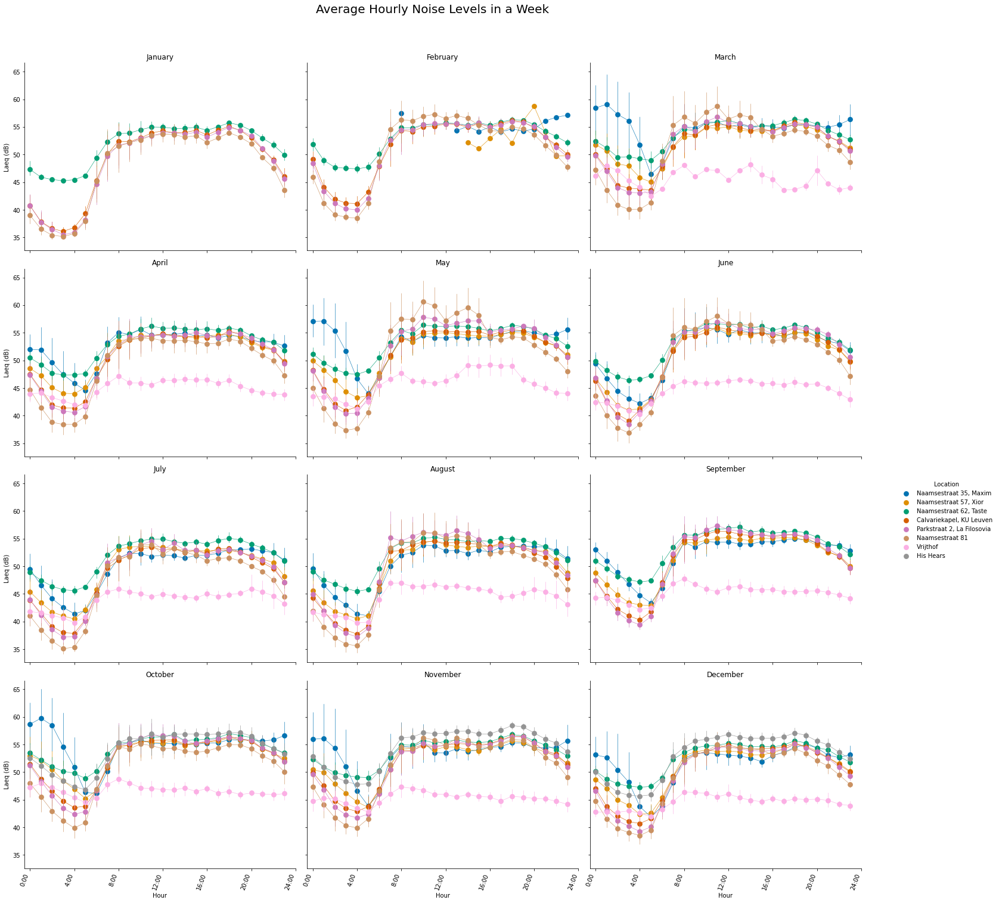

In [8]:
# Set the figure size for the plot
plt.figure(figsize=(10, 6))

# Create a catplot for each month
grid = sns.catplot(
    data=sampled_df,
    x='hour',
    y='laeq',
    hue='Location',
    col='month',
    col_wrap=3,
    kind='point',
    height=5,
    aspect=1.2,
    palette='colorblind',
    legend=True,
    legend_out=True,
)

# Set titles for each subplot and adjust properties
for i, ax in enumerate(grid.axes.flat):
    ax.set_title(f"Month {i+1}")
    
    # Label every 4th hour on the x-axis
    ax.set_xticks(range(0, 25, 4))

    # Rotate x-axis labels by 70 degrees
    ax.set_xticklabels(['0:00', '4:00', '8:00', '12:00', '16:00', '20:00', '24:00'], rotation=70, ha='right', fontsize=10)
    

    # Make lines thinner
    for line in ax.lines:
        line.set_linewidth(0.6)
        
# Set plot titles as month names
month_names = calendar.month_name[1:]  # Exclude empty string at index 0
for ax, month in zip(grid.axes.flat, month_names):
    ax.set_title(month)

# Adjust the spacing between subplots
plt.tight_layout()
sns.move_legend(grid, loc='upper right', bbox_to_anchor=(1.15, 0.5))

# Rename the legend title and increase its size
grid._legend.set_title("Location")

# Set x-axis label
grid.set_axis_labels("Hour", "Laeq (dB)", fontsize=10)

# Set plot title
grid.fig.suptitle("Average Hourly Noise Levels in a Week", y=1.05, fontsize=20)

# Show the plot
plt.show()


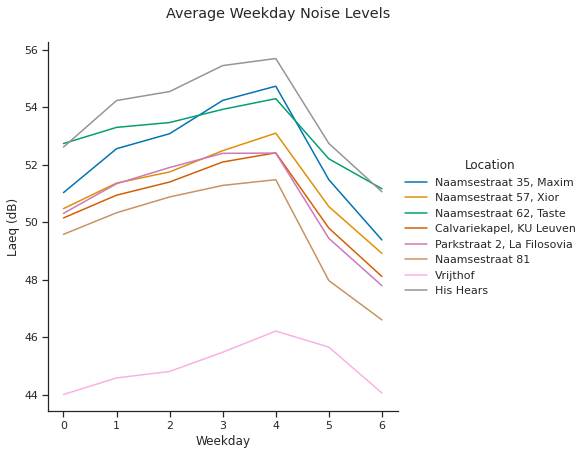

In [9]:
# Set the seaborn theme
sns.set_theme(style="ticks")

# Define the palette as a color-blind friendly palette
palette = "colorblind"

# Plot the lines on two facets
g =sns.relplot(
    data=yearly_sampled_df,
    x="day_of_week",y= 'laeq',
    hue="Location",
    kind="line", size_order=[1, 2],
    ci=None,
    height=6, facet_kws=dict(sharex=False),
    palette = 'colorblind'
)

# Rename the legend title and increase its size
g._legend.set_title("Location")

# Set x-axis label
g.set_axis_labels("Weekday", "Laeq (dB)")

# Set plot title
g.fig.suptitle("Average Weekday Noise Levels", y=1.05)

# Show the plot
plt.show()

In [10]:
# Create a more detailed plot with average hour for each day in a month 

#Add the day of the week + the time#
dataframe['time'] = dataframe['result_timestamp'].dt.time #Create time variable for sampling.
dataframe['time'] = dataframe['time'].astype(str)
dataframe['day_name'] = dataframe['result_timestamp'].dt.day_name()
dataframe['daytime'] = dataframe['day_name'] + dataframe['time']

#Sample data with the new variable 
average_noise_df = dataframe.groupby(['daytime', 'object_id'])['laeq'].mean().reset_index()


In [11]:
# Add the location variable 
average_noise_df['object_id'] = average_noise_df['object_id'].astype(int)


# Define a dictionary mapping object_id to location information
location_dict = {
    255439: "Naamsestraat 35, Maxim",
    255440: "Naamsestraat 57, Xior",
    255441: "Naamsestraat 62, Taste",
    255442: "Calvariekapel, KU Leuven",
    255443: "Parkstraat 2, La Filosovia",
    255444: "Naamsestraat 81",
    255445: "Kiosk, Stadspark",
    280324: "Vrijthof",
    303910: "His Hears"
}

# Add the 'Location' column to the sampled_df DataFrame
average_noise_df['Location'] = average_noise_df['object_id'].map(location_dict)

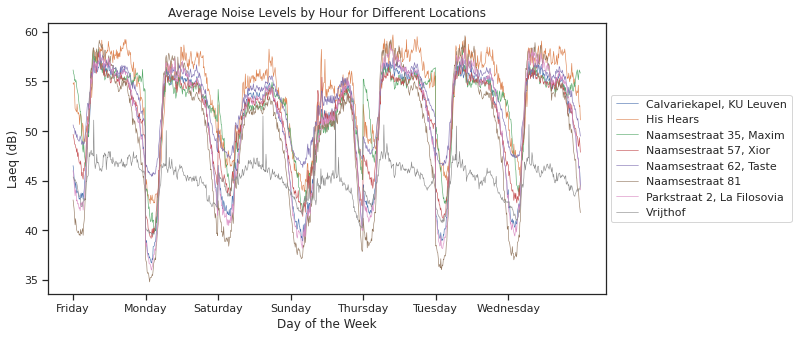

In [12]:

plt.figure(figsize=(10, 5))

# Group the data by 'object_id'
grouped_df = average_noise_df.groupby('Location')

# Loop through each group and plot the average noise levels
for object_id, group in grouped_df:
    plt.plot(group['daytime'], group['laeq'], label=object_id, linewidth=0.6)

# Set the title and labels for the plot
plt.title("Average Noise Levels by Hour for Different Locations")
plt.xlabel("Day of the Week")
plt.ylabel("Laeq (dB)")

plt.xticks(['Monday00:00:00', 'Tuesday00:00:00', 'Wednesday00:00:00', 'Thursday00:00:00', 'Friday00:00:00', 'Saturday00:00:00', 'Sunday00:00:00'],
        ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# Set the legend outside the graph
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()


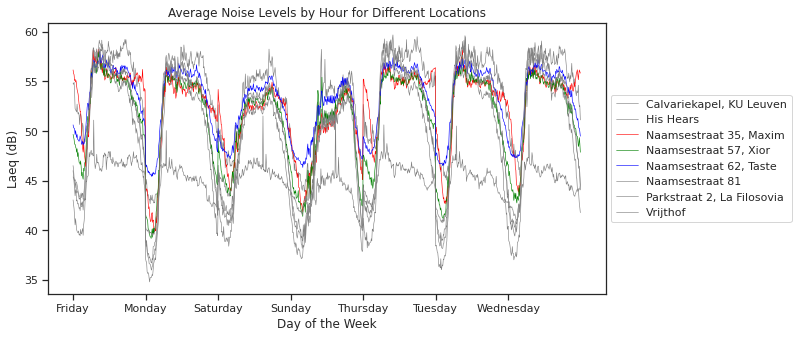

In [13]:

plt.figure(figsize=(10, 5))

# Define the colors for different locations
colors = {
    255439: 'red',  # Naamsestraat 35, Maxim
    255440: 'green',  # Naamsestraat 57, Xior
    255441: 'blue',  # Naamsestraat 62, Taste
}

# Group the data by 'Location'
grouped_df = average_noise_df.groupby('Location')

# Loop through each group and plot the average noise levels with the respective color
for location, group in grouped_df:
    object_id = group['object_id'].iloc[0]
    if object_id in colors:
        plt.plot(group['daytime'], group['laeq'], label=location, linewidth=0.6, color=colors[object_id])
    else:
        plt.plot(group['daytime'], group['laeq'], label=location, linewidth=0.6, color='gray')

# Set the title and labels for the plot
plt.title("Average Noise Levels by Hour for Different Locations")
plt.xlabel("Day of the Week")
plt.ylabel("Laeq (dB)")

plt.xticks(['Monday00:00:00', 'Tuesday00:00:00', 'Wednesday00:00:00', 'Thursday00:00:00', 'Friday00:00:00', 'Saturday00:00:00', 'Sunday00:00:00'],
        ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'])

# Set the legend outside the graph
plt.legend(loc='center left', bbox_to_anchor=(1, 0.5))

# Show the plot
plt.show()
